In [1]:

import numpy as np
import torch
import random
from collections import deque
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import datetime
import pickle
import math
import matplotlib.pyplot as plt

In [2]:
def plot_learning_curve(x, scores, figure_file):
    running_avg_score = np.zeros(len(scores))
    for i in range(len(running_avg_score)):
        running_avg_score[i] = np.mean(scores[max(0, i-100):(i+1)])
    plt.plot(x, running_avg_score, '-b')
    plt.title('Média móvel das últimas 100 pontuações')
    plt.savefig(figure_file)

def plot_success_curve(x, successes, figure_file):
    running_success_rate = np.zeros(len(successes))
    for i in range(len(running_success_rate)):
        running_success_rate[i] = np.mean(successes[max(0, i-50):(i+1)])
    plt.plot(x, running_success_rate, '-g')
    plt.title('Taxa de sucesso dos últimos 50 episódios')
    plt.savefig(figure_file)

def plot_step_curve(x, steps, figure_file):
    running_step_avg = np.zeros(len(steps))
    for i in range(len(running_step_avg)):
        running_step_avg[i] = np.mean(steps[max(0, i-200):(i+1)])
    plt.plot(x, running_step_avg, '-g')
    plt.title('Média móvel da duração dos últimos 200 episódios')
    plt.savefig(figure_file)

In [3]:
import mujoco
import mediapy as media
import random

class MujocoEnv1_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 9
        self.name = "MujocoEnv-v1-0"
        self.theta1 = 0
        self.theta2 = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.05
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.data.qpos[0:3] = [-1,-1,2.5]
        self.data.qvel[0:3] = [2.75,1,3]
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0)
    
    def calculaTarget(self):
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        tempo_queda = (vz0+np.sqrt(np.abs(vz0**2+2*9.8*(z0-0.589))))/9.8
        targetx = x0 + tempo_queda*vx0
        targety = y0 + tempo_queda*vy0
        return targetx, targety
    def calculaDistanciaTarget(self, targetx, targety):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-targetx)**2 + (self.data.geom_xpos[9,1].copy()-targety)**2)
    def calculaDistancia(self):
        xo,yo,zo = self.data.geom_xpos[1].copy()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return np.sqrt((xo-xc)**2+(yo-yc)**2+(zo-zc)**2)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget(*self.calculaTarget())
        reward = -5*distancia
        if self.data.time > 3 or self.data.qpos[2] < 0.2:
            done = True
        if self.calculaDistancia() < 0.05:
            done = True
            reward += 200
            print('success')
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget(*self.calculaTarget())
        reward = -10*distancia**2
        if self.data.time > 3 or self.data.qpos[2] < 0.2:
            done = True
        if self.calculaDistancia() < 0.05:
            done = True
            reward += 200
            print('success')
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0), reward, done

class MujocoEnv1_1:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 9
        self.name = "MujocoEnv-v1-1"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)

        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        return (xc,yc,self.targetx,self.targety)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

class MujocoEnv1_2:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 9
        self.name = "MujocoEnv-v1-2"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)

        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety), reward, done

class MujocoEnv0_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 9
        self.name = "MujocoEnv-v0-0"
        self.theta1 = 0
        self.theta2 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.05
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        xc,yc,zc = self.data.geom_xpos[9].copy()
        ang = random.uniform(-np.pi,np.pi)
        r = random.uniform(1,1.7)
        self.targetx = r*np.sin(ang)
        self.targety = r*np.cos(ang)
        return (xc,yc,self.targetx,self.targety)
    
    def calculaDistanciaTarget(self, targetx, targety):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-targetx)**2 + (self.data.geom_xpos[9,1].copy()-targety)**2)
    
    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget(self.targetx,self.targety)
        reward = -2*distancia -2
        if self.data.time > 5:
            done = True
        if distancia < 0.15:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget(self.targetx,self.targety)
        reward = -2*distancia -2
        if self.data.time > 5:
            done = True
        if distancia < 0.15:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

class MujocoEnv2_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 9
        self.name = "MujocoEnv-v2-0"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        print(self.data)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.tfin = self.data.time
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < 0.05:
            done = True
            self.tfin = self.data.time
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

class MujocoEnv2_1:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 9
        self.name = "MujocoEnv-v2-1"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.dist = 0.45
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0

        self.angle = 0
        self.radius = 0  

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def setNextDistancia(self):
        if self.dist>0.06:
            self.dist = self.dist*0.8

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def getBolaFixa(self):
        self.x0 = self.radius*np.cos(self.angle)
        self.y0 = self.radius*np.sin(self.angle)
        self.z0 = 2.5
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 2.5
        self.calculaTarget()

    def variaPos(self,radius,angle):
        self.radius = radius
        self.angle = angle

    def resetFixo(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getBolaFixa()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        self.dist = 0.08
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 2*action[0]
        omega2 = 2*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.dist:
            done = True
            reward += 200
            print('success')
            self.tfin = self.data.time
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 2*action[0]
        omega2 = 2*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.dist:
            done = True
            self.tfin = self.data.time
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

class MujocoEnv2_2:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 9
        self.name = "MujocoEnv-v2-2"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.distlist = [1.6,0.8,0.4,0.06]
        self.distcount = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0
        self.successes = 0

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        d = self.calculaDistanciaTarget()
        self.distlist = [0.75*d,0.5*d,0.25*d,0.06]
        if d < 0.06: self.distlist = [0.06]
        self.distcount = 0
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.distlist[self.distcount]:
            self.distcount += 1
            reward += 100
            self.successes += 1
        if self.distcount == len(self.distlist):
            done = True
            reward += 100
            print('success')
            self.tfin = self.data.time
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            ...
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.distlist[self.distcount]:
            self.distcount += 1
            reward += 100
            self.successes += 1
        if self.distcount == len(self.distlist):
            done = True
            reward += 100
            print('success')
            self.tfin = self.data.time
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

In [4]:
MODEL_FILE = "./ddqn_mujoco_model"
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class ExperienceReplay:
    def __init__(self, buffer_size):
        self.buffer = deque(maxlen=buffer_size)

    def __len__(self):
        return len(self.buffer)

    # Add a transition to the memory by basic SARNS convention. 
    def store_transition(self, state, action, reward, new_state, done):
        # If buffer is abuot to overflow, begin rewriting existing memory? 
        self.buffer.append((state, action, reward, new_state, done))

    # Sample only the memory that has been stored. Samples BATCH
    # amount of samples. 
    def sample(self):
        sample = random.sample(self.buffer, BATCH_SIZE)
        states, actions, rewards, next_states, dones = zip(*sample)
        #print ("actions",actions)
        states = torch.tensor(states).float().to(DEVICE)
        actions = torch.stack(actions).long().to(DEVICE)
        rewards = torch.from_numpy(np.array(rewards, dtype=np.float32).reshape(-1, 1)).to(DEVICE)
        next_states = torch.tensor(next_states).float().to(DEVICE)
        dones = torch.from_numpy(np.array(dones, dtype=np.uint8).reshape(-1, 1)).float().to(DEVICE)
        return (states, actions, rewards, next_states, dones)

class QNetwork(nn.Module):
    def __init__(self, state_dim, action_dim):
        super(QNetwork, self).__init__()
        # Make a simple 3 later linear network
        self.l1 = nn.Linear(state_dim, 512)
        self.l2 = nn.Linear(512, 256)
        self.l3 = nn.Linear(256, action_dim)
        #self.max_action = max_action

    def forward(self, state):
        x = F.relu(self.l1(state))
        x = F.relu(self.l2(x))
        #x = self.max_action * torch.tanh(self.l3(x))
        return self.l3(x)

class Agent():
    # Initialize the agent
    def __init__(self, state_dim, action_dim):
        self.memory = ExperienceReplay(MEM_SIZE)
        self.action_dim = action_dim
        self.main_model = QNetwork(state_dim, action_dim).to(DEVICE)
        self.target_model = QNetwork(state_dim, action_dim).to(DEVICE)
        self.optimizer = optim.Adam(self.main_model.parameters(), lr=LR)
        self.eps = 1
        self.eps_decay = 0.999
        self.eps_min = 0.01

        # Target model will be a copy of the main model and will not be trained
        self.target_model.load_state_dict(self.main_model.state_dict())
        self.target_model.eval()

    # Agent saves its experiences and learn
    def step(self, state, action, reward, new_state, done):
        # Stores the transition into Experience Replay
        self.memory.store_transition(state, action, reward, new_state, done)

        # Agent will only learn when there are enough experiences
        if len(self.memory) > BATCH_SIZE:
            self.learn()

    # Agent learns
    def learn(self):
        # Sample random minibatch of transitions from Experience Replay
        state, action, reward, new_state, done = self.memory.sample()
        #print("state",state,len(state),"\n action",action,len(action))
      
        #print ("target",self.main_model(state))
        # Computes Q(s_{curr},a') then chooses columns of actions that were taken for each batch
        q_eval = self.main_model(state).gather(1,action.unsqueeze(1))
        #print("a",self.main_model(state)[1],action[1],q_eval[1])

        # Clone the model and use it to generate Q learning targets for the main model
        # Also predicts the max Q value for the next state
        #print ("target",self.main_model(state))
        q_next = self.target_model(new_state).detach().max(1)[0].unsqueeze(1)
        #print("b",self.target_model(new_state)[1],q_next[1])

        # Q learning targets = r if next state is terminal or
        # Q learning targets = r + GAMMA*(Q(s_{next},a')) if next state is not terminal
        q_target = reward + GAMMA*(q_next) *(1-done)

        # Compute MSE loss
        loss = F.mse_loss(q_eval, q_target)

        # Stochastic gradient descent on the loss function and does backpropragation
        self.optimizer.zero_grad()
        loss.backward()
        '''for param in self.main_model.parameters():
            # Clip the error term to be between -1 and 1
            param.grad.data.clamp_(-1,1)'''
        self.optimizer.step()

    def decrement_epsilon(self):
        self.eps *= self.eps_decay 
        if self.eps < self.eps_min:
            self.eps = self.eps_min

    # Action chosen is either a random action or based on the Bellman Equation
    def take_action(self,action):
        ternary = np.base_repr(action, base=3)
        ternary = ternary.zfill(2)
        #print(enumerate(ternary))
        action_array = np.zeros(2)
        for i,n in enumerate(ternary):
            #print("n",n)
            action_array[i] = (int(n) - 1)
        #print ("oi",action_array)
        return action_array
    
    def choose_action(self, state):
        # With probability EPSILON, select a random action
        #print (state)
        if np.random.random() < self.eps:
            #return torch.from_numpy(self.action_space.sample())
            acao = random.randint(0,8)
            
        # Otherwise select the action with the highest Q value
        else: 
            #print (state)
            state = torch.FloatTensor(np.array(state).reshape(1,-1)).to(DEVICE)
            #print ("state",state)
            
            # action that maximizes Q*(s',a';THETA)  
            with torch.no_grad():
                acao = self.main_model(state).max(1)[1].item()
                #print ("escolhe",self.main_model(state),acao)
        return acao
    
    def soft_update_target_model(self, tau):
        target_model_state_dict = self.target_model.state_dict()
        main_model_state_dict = self.main_model.state_dict()
        
        for key in main_model_state_dict:
            target_model_state_dict[key] = main_model_state_dict[key] * tau + target_model_state_dict[key] * (1 - tau)
        
        self.target_model.load_state_dict(target_model_state_dict)


def save_model(model, path):
    torch.save(model.state_dict(), path)

def load_model(model, path):
    model.load_state_dict(torch.load(path))
    return model

def replay_actions(env, actions):
    done = False
    state = env.reset()
    for action in actions:
        env.render()
        env.step(action)
    env.close()

def store_actions(actions, path):
    actions_file = open(path,'wb')
    pickle.dump(actions, actions_file)
    actions_file.close()

def load_actions(path):
    actions_file = open(path,'rb')
    actions = pickle.load(actions_file)
    actions_file.close()

    return actions

In [6]:
# Hyperparameters
N_GAMES = 30001
MEM_SIZE = 100000
BATCH_SIZE = 32
TARGET_UPDATE = 4
GAMMA = 0.99
TAU = 0.005
LR = 1e-4


In [ ]:
def main():
    plt.ion()
    env = MujocoEnv2_0()
    state_dim = env.state_dim
    action_dim = env.action_dim
    agent = Agent(state_dim, action_dim)

    load = input("load from model? [y/n]: ")
    
    filename = 'DDQN_mujoco'
    figure_file_score = 'plots/' + filename + '_score.png'
    figure_file_catchrate = 'plots/' + filename + '_catchrate.png'
    figure_file_steps = 'plots/' + filename + '_steps.png'

    if load == "y":
        agent.main_model = load_model(agent.main_model, MODEL_FILE)
        agent.target_model = load_model(agent.main_model, MODEL_FILE)
        actions = load_actions(MODEL_FILE+'_actions')
        agent.eps = agent.eps_min

    max_score = -10000
    max_game = 0
    scores = []
    start = datetime.datetime.now()
    
    step_history = []
    score_history = []
    success_history = []

    for game in range(N_GAMES):
        done = False
        score = 0
        success = 0
        observation = env.reset()
        #print(observation)
        game_actions = [] # actions taken during this game
        episode_start = datetime.datetime.now()

        if game%500 != 499:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.step(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
        else:
            while not done:
                action = agent.choose_action(observation)
                observation_, reward, done = env.rstep(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
            media.show_video(env.frames, fps=env.framerate)

        # Update variables each game
        agent.decrement_epsilon()
        episode_end = datetime.datetime.now()
        elapsed = episode_end - episode_start
        scores.append(score)
        avg_score = np.mean(scores[-100:])
        
        step_history.append(env.tfin)
        score_history.append(score)
        success_history.append(success)

        # Checks if the max score has been beaten
        if score > max_score:
            max_score = score
            max_game = game

            save_model(agent.main_model, MODEL_FILE)
            store_actions(game_actions, MODEL_FILE+'_actions')

        print("eps:",agent.eps)
        print('game:', game)
        print('steps',env.tfin)
        print('reward:', str(score))
        print("max reward:", str(max_score), "at game", str(max_game))
        print('average score for the last 100 games:', avg_score)
        print('time:', str(elapsed.total_seconds()),'seconds')
        print()

    # After going through N_GAMES
    end = datetime.datetime.now()
    elapsed = end - start

    print('Total time:',elapsed.total_seconds(), 'seconds')
    
    x = [i+1 for i in range(N_GAMES)]
    %matplotlib inline
    plt.figure('learning')
    plot_learning_curve(x, score_history, figure_file_score)
    plt.figure('catching')
    plot_success_curve(x, success_history, figure_file_catchrate)
    plt.figure('steps')
    plot_step_curve(x, step_history, figure_file_steps)

    scores_file = open(MODEL_FILE+'_scores','wb')
    pickle.dump(scores, scores_file)
    scores_file.close()

main()

eps: 0.999
game: 0
reward: -651.1368563954239
average score for the last 100 games: -651.1368563954239
partial success avg 0.00  dist 0.45
time: 0.426668 seconds

eps: 0.998001
game: 1
reward: -499.2723537067085
average score for the last 100 games: -575.2046050510662
partial success avg 0.00  dist 0.45
time: 0.360975 seconds

eps: 0.997002999
game: 2
reward: -770.0068261627824
average score for the last 100 games: -640.1386787549717
partial success avg 0.00  dist 0.45
time: 0.382242 seconds

eps: 0.996005996001
game: 3
reward: -685.7878616610448
average score for the last 100 games: -651.5509744814899
partial success avg 0.00  dist 0.45
time: 0.378834 seconds

success
eps: 0.995009990004999
game: 4
reward: 197.20822560345638
average score for the last 100 games: -481.79913446450064
partial success avg 0.20  dist 0.45
time: 0.007681 seconds

eps: 0.994014980014994
game: 5
reward: -462.825851088521
average score for the last 100 games: -478.6369205685041
partial success avg 0.17  dist 0

eps: 0.8178301806491574
game: 200
reward: -42.0705514835208
average score for the last 100 games: -363.907638763532
partial success avg 0.39  dist 0.45
time: 0.663276 seconds

success
eps: 0.8170123504685082
game: 201
reward: -60.936037670686574
average score for the last 100 games: -356.05301970594815
partial success avg 0.40  dist 0.45
time: 0.253464 seconds

eps: 0.8161953381180397
game: 202
reward: -642.3633269832745
average score for the last 100 games: -363.3795083318999
partial success avg 0.39  dist 0.45
time: 0.38146 seconds

success
eps: 0.8153791427799216
game: 203
reward: -412.62298248902823
average score for the last 100 games: -359.23908540987344
partial success avg 0.40  dist 0.45
time: 0.375865 seconds

success
eps: 0.8145637636371417
game: 204
reward: 20.15194341635933
average score for the last 100 games: -349.5512624271971
partial success avg 0.41  dist 0.45
time: 0.140077 seconds

success
eps: 0.8137491998735046
game: 205
reward: 11.616820441566603
average score for

eps: 0.6057725659163237
game: 500
reward: 11.385624265069907
average score for the last 100 games: -82.52730124464071
partial success avg 0.72  dist 0.45
time: 0.677267 seconds

eps: 0.6051667933504074
game: 501
reward: -353.9305672868701
average score for the last 100 games: -87.87660936335698
partial success avg 0.71  dist 0.45
time: 0.453852 seconds

success
eps: 0.6045616265570569
game: 502
reward: 197.06246551303624
average score for the last 100 games: -79.82881128581064
partial success avg 0.72  dist 0.45
time: 0.007495 seconds

eps: 0.6039570649304998
game: 503
reward: -376.9880828329654
average score for the last 100 games: -79.80644006875069
partial success avg 0.71  dist 0.45
time: 0.418178 seconds

success
eps: 0.6033531078655693
game: 504
reward: -181.58290903234956
average score for the last 100 games: -81.71683215525051
partial success avg 0.71  dist 0.45
time: 0.260778 seconds

success
eps: 0.6027497547577038
game: 505
reward: -168.20401155132674
average score for the l

eps: 0.36732772934619257
game: 1000
reward: 183.47962283316767
average score for the last 100 games: 11.83810291337182
partial success avg 0.83  dist 0.45
time: 0.647192 seconds

success
eps: 0.3669604016168464
game: 1001
reward: 180.4500469204011
average score for the last 100 games: 11.665431608876336
partial success avg 0.83  dist 0.45
time: 0.035515 seconds

success
eps: 0.3665934412152296
game: 1002
reward: 118.53670082588665
average score for the last 100 games: 10.916689102150784
partial success avg 0.83  dist 0.45
time: 0.104075 seconds

success
eps: 0.3662268477740143
game: 1003
reward: -197.40287289556238
average score for the last 100 games: 7.751727562455712
partial success avg 0.83  dist 0.45
time: 0.320871 seconds

success
eps: 0.36586062092624033
game: 1004
reward: 144.01016638488994
average score for the last 100 games: 8.501881023984119
partial success avg 0.83  dist 0.45
time: 0.055365 seconds

success
eps: 0.3654947603053141
game: 1005
reward: 126.65759128633546
aver

eps: 0.21848405696585643
game: 2000
reward: 197.28240906396917
average score for the last 100 games: 67.53967536750295
partial success avg 0.86  dist 0.36
time: 0.64966 seconds

success
eps: 0.21826557290889056
game: 2001
reward: 187.95213146899505
average score for the last 100 games: 67.76567030644831
partial success avg 0.86  dist 0.36
time: 0.029045 seconds

success
eps: 0.21804730733598168
game: 2002
reward: 153.58976391235305
average score for the last 100 games: 67.3234786769891
partial success avg 0.86  dist 0.36
time: 0.048744 seconds

success
eps: 0.2178292600286457
game: 2003
reward: 45.57001275534631
average score for the last 100 games: 66.77206290638661
partial success avg 0.86  dist 0.36
time: 0.108119 seconds

success
eps: 0.21761143076861705
game: 2004
reward: 152.77225464353452
average score for the last 100 games: 66.65606624632605
partial success avg 0.86  dist 0.36
time: 0.078568 seconds

success
eps: 0.21739381933784843
game: 2005
reward: 168.40201364264243
averag

eps: 0.1312667189769854
game: 5000
reward: 148.77865664921146
average score for the last 100 games: 47.002347192097304
partial success avg 0.80  dist 0.18
time: 0.662838 seconds

eps: 0.13113545225800843
game: 5001
reward: -286.6989969914695
average score for the last 100 games: 42.592212166366735
partial success avg 0.79  dist 0.18
time: 0.467872 seconds

success
eps: 0.13100431680575042
game: 5002
reward: 35.609558751628896
average score for the last 100 games: 45.401711022899974
partial success avg 0.80  dist 0.18
time: 0.179489 seconds

success
eps: 0.13087331248894468
game: 5003
reward: 178.55379811964946
average score for the last 100 games: 50.37610383879399
partial success avg 0.81  dist 0.18
time: 0.04795 seconds

success
eps: 0.13074243917645573
game: 5004
reward: 55.86201818660945
average score for the last 100 games: 49.05757473556666
partial success avg 0.81  dist 0.18
time: 0.118887 seconds

success
eps: 0.13061169673727926
game: 5005
reward: 70.50010864150946
average sco

eps: 0.01
game: 10000
reward: 162.83769302727757
average score for the last 100 games: 76.00328975573811
partial success avg 0.81  dist 0.15
time: 0.665607 seconds

success
eps: 0.01
game: 10001
reward: 168.16069039959595
average score for the last 100 games: 76.2930098781805
partial success avg 0.81  dist 0.15
time: 0.079222 seconds

eps: 0.01
game: 10002
reward: -217.3948009380277
average score for the last 100 games: 72.43631671484745
partial success avg 0.80  dist 0.15
time: 0.435507 seconds

success
eps: 0.01
game: 10003
reward: 37.22296884947107
average score for the last 100 games: 71.00796428435578
partial success avg 0.80  dist 0.15
time: 0.108795 seconds

success
eps: 0.01
game: 10004
reward: 66.36896692489142
average score for the last 100 games: 70.31125245906331
partial success avg 0.80  dist 0.15
time: 0.092567 seconds

success
eps: 0.01
game: 10005
reward: 169.81920971141224
average score for the last 100 games: 70.55361422173259
partial success avg 0.80  dist 0.15
time:

eps: 0.01
game: 15000
reward: -133.97382049205174
average score for the last 100 games: 55.323440243709655
partial success avg 0.77  dist 0.12
time: 0.770303 seconds

success
eps: 0.01
game: 15001
reward: 159.24631197160443
average score for the last 100 games: 55.014425021755834
partial success avg 0.77  dist 0.12
time: 0.050503 seconds

success
eps: 0.01
game: 15002
reward: 158.47417751329778
average score for the last 100 games: 58.381404939593075
partial success avg 0.78  dist 0.12
time: 0.063822 seconds

success
eps: 0.01
game: 15003
reward: 55.08058217364675
average score for the last 100 games: 57.67940153531162
partial success avg 0.78  dist 0.12
time: 0.372205 seconds

success
eps: 0.01
game: 15004
reward: 61.539430942694
average score for the last 100 games: 60.318848987656175
partial success avg 0.79  dist 0.12
time: 0.12351 seconds

success
eps: 0.01
game: 15005
reward: 160.8757105179564
average score for the last 100 games: 60.07252661682856
partial success avg 0.79  dist 

eps: 0.030543240102790723
game: 20000
reward: 192.62278751305462
average score for the last 100 games: 12.827801837939772
partial success avg 0.66  dist 0.09
time: 0.773549 seconds

success
eps: 0.030512696862687934
game: 20001
reward: 179.15174262941144
average score for the last 100 games: 13.593980822257974
partial success avg 0.66  dist 0.09
time: 0.056217 seconds

eps: 0.030482184165825245
game: 20002
reward: -147.4742102642011
average score for the last 100 games: 13.908520162600698
partial success avg 0.66  dist 0.09
time: 0.393503 seconds

success
eps: 0.030451701981659418
game: 20003
reward: 137.04195038138943
average score for the last 100 games: 14.287444412357917
partial success avg 0.66  dist 0.09
time: 0.151848 seconds

success
eps: 0.030421250279677757
game: 20004
reward: 117.41068138504212
average score for the last 100 games: 17.220290351142488
partial success avg 0.67  dist 0.09
time: 0.096646 seconds

success
eps: 0.03039082902939808
game: 20005
reward: 156.419056449

eps: 0.01
game: 25000
reward: 181.9019231921104
average score for the last 100 games: 55.50786389129721
partial success avg 0.76  dist 0.09
time: 0.792594 seconds

success
eps: 0.01
game: 25001
reward: 168.35440907451556
average score for the last 100 games: 55.553650611260764
partial success avg 0.76  dist 0.09
time: 0.080075 seconds

success
eps: 0.01
game: 25002
reward: 145.93423360727272
average score for the last 100 games: 55.80024996923288
partial success avg 0.76  dist 0.09
time: 0.142684 seconds

success
eps: 0.01
game: 25003
reward: 104.49663937622896
average score for the last 100 games: 58.12736753378967
partial success avg 0.77  dist 0.09
time: 0.082099 seconds

success
eps: 0.01
game: 25004
reward: 68.60494561892136
average score for the last 100 games: 58.11839038835372
partial success avg 0.77  dist 0.09
time: 0.127209 seconds

success
eps: 0.01
game: 25005
reward: 122.00184953749608
average score for the last 100 games: 58.378925861200706
partial success avg 0.77  dist

eps: 0.19404071426010078
game: 30000
reward: -275.7732320792031
average score for the last 100 games: 37.83125870354265
partial success avg 0.75  dist 0.08
time: 0.765057 seconds

Total time: 30537.580162 seconds


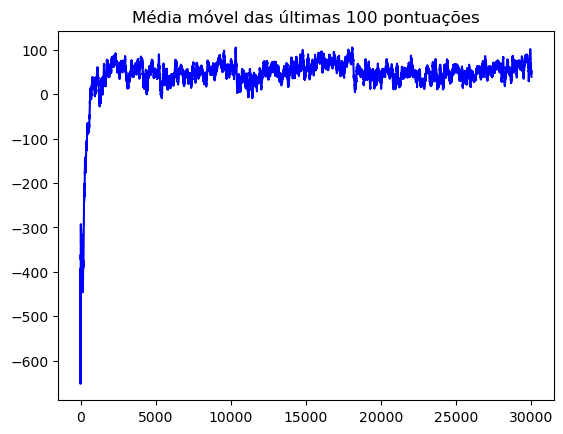

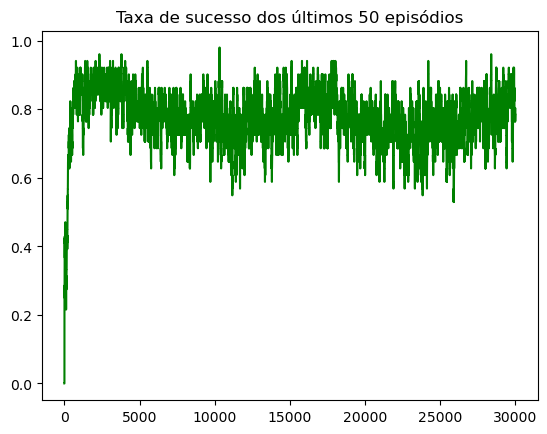

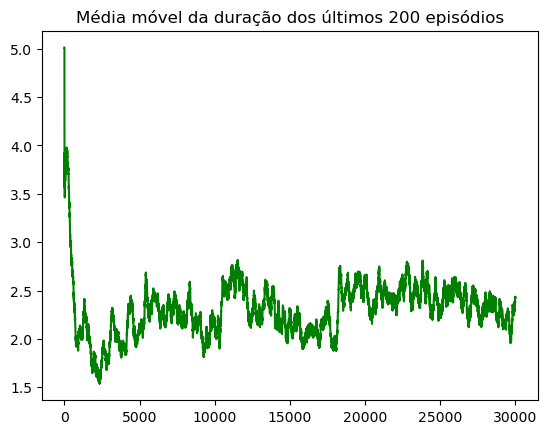

In [20]:
   ### RECOMPENSA DINÂMICA ###

# Hyperparameters
N_GAMES = 30001
MEM_SIZE = 100000
BATCH_SIZE = 32
TARGET_UPDATE = 4
GAMMA = 0.99
TAU = 0.005
LR = 1e-4

steps_taken = 0

if __name__ == '__main__':
    plt.ion()
    env = MujocoEnv2_1()
    state_dim = env.state_dim
    action_dim = env.action_dim
    agent = Agent(state_dim, action_dim)

    load = input("load from model? [y/n]: ")
    
    filename = 'DDQN_mujoco'
    figure_file_score = 'plots/' + filename + '_score.png'
    figure_file_catchrate = 'plots/' + filename + '_catchrate.png'
    figure_file_steps = 'plots/' + filename + '_steps.png'

    if load == "y":
        agent.main_model = load_model(agent.main_model, MODEL_FILE)
        agent.target_model = load_model(agent.main_model, MODEL_FILE)
        actions = load_actions(MODEL_FILE+'_actions')
        agent.eps = agent.eps_min

    max_score = -10000
    max_game = 0
    scores = []
    start = datetime.datetime.now()

    step_history = []
    score_history = []
    success_history = []
    partial_success_history = []
    next_level_points = []

    for game in range(N_GAMES):
        done = False
        score = 0
        success = 0
        observation = env.reset()
        #print(observation)
        game_actions = [] # actions taken during this game
        episode_start = datetime.datetime.now()

        if game not in [200,500,1000,2000,5000,10000,15000,20000,25000,30000]:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.step(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
        else:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.rstep(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
            media.show_video(env.frames, fps=env.framerate)

        # Update variables each game
        agent.decrement_epsilon()
        episode_end = datetime.datetime.now()
        elapsed = episode_end - episode_start
        scores.append(score)
        avg_score = np.mean(scores[-100:])
        
        step_history.append(env.tfin)
        score_history.append(score)
        success_history.append(success)
        partial_success_history.append(success)

        # Checks if the max score has been beaten
        if score > max_score:
            max_score = score
            max_game = game

            save_model(agent.main_model, MODEL_FILE)
            store_actions(game_actions, MODEL_FILE+'_actions')

        if len(partial_success_history)>600 and np.mean(partial_success_history[-100:])>0.9:
            partial_success_history = []
            env.setNextDistancia()
            agent.eps += 0.2
            next_level_points.append(game)
            print('NEXT LEVEL')

        print("eps:",agent.eps)
        print('game:', game)
        print('reward:', str(score))
        print('average score for the last 100 games:', avg_score)
        print('partial success avg %.2f' %np.mean(partial_success_history[-100:]), ' dist %.2f' %env.dist)
        print('time:', str(elapsed.total_seconds()),'seconds')
        print()

    # After going through N_GAMES
    end = datetime.datetime.now()
    elapsed = end - start

    print('Total time:',elapsed.total_seconds(), 'seconds')
    
    x = [i+1 for i in range(N_GAMES)]
    %matplotlib inline
    plt.figure('learning')
    plot_learning_curve(x, score_history, figure_file_score)
    plt.figure('catching')
    plot_success_curve(x, success_history, figure_file_catchrate)
    plt.figure('steps')
    plot_step_curve(x, step_history, figure_file_steps)

    scores_file = open(MODEL_FILE+'_scores','wb')
    pickle.dump(scores, scores_file)
    scores_file.close()

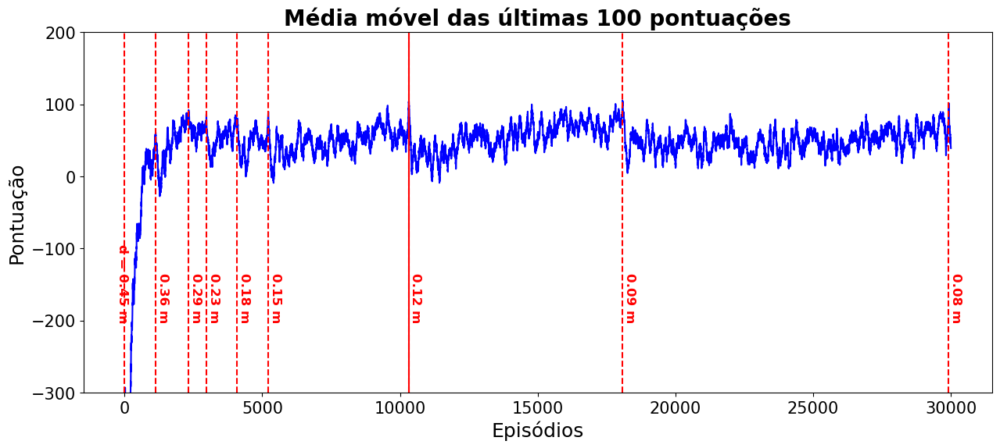

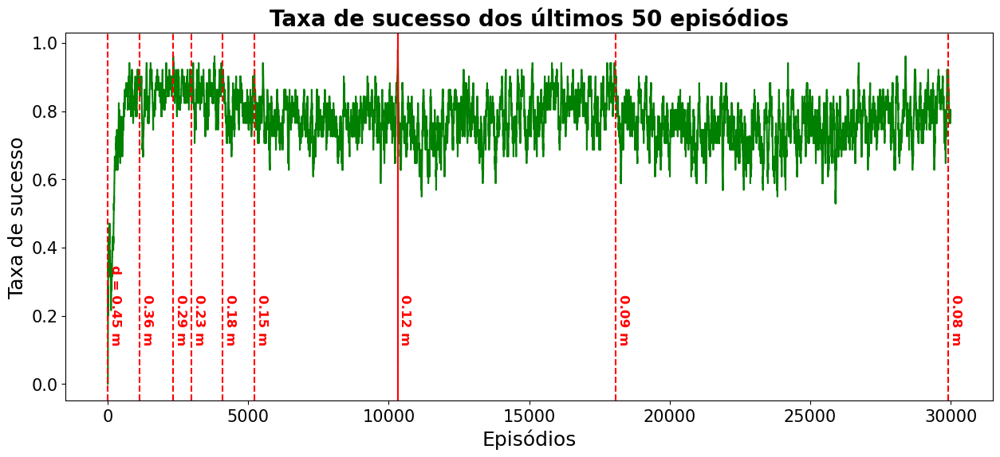

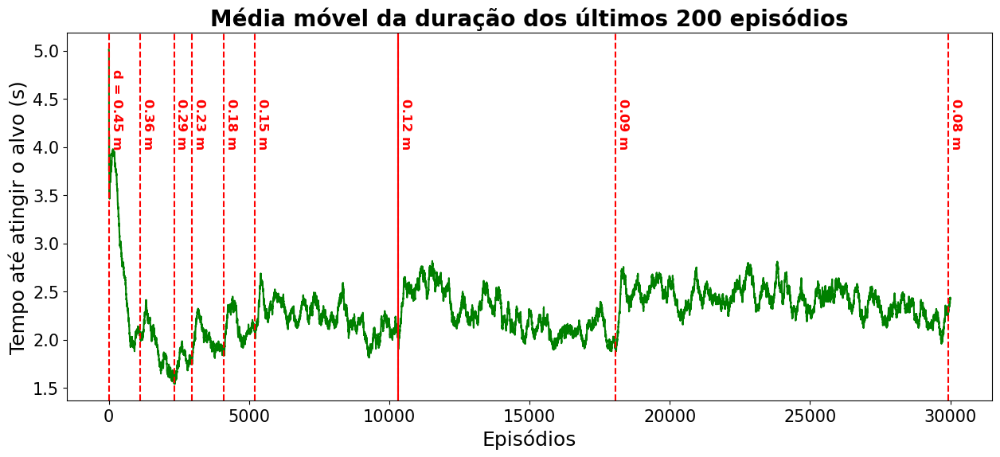

In [21]:
def plot_learning_curve(x, scores, figure_file):
    running_avg_score = np.zeros(len(scores))
    for i in range(len(running_avg_score)):
        running_avg_score[i] = np.mean(scores[max(0, i-100):(i+1)])
    plt.plot(x, running_avg_score, '-b')
    plt.ylim(-300,200)
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Pontuação',fontsize='18')
    plt.axvline(x=next_level_points[-3], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(-300,-200,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,-200,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Média móvel das últimas 100 pontuações',size='20',weight='bold')
    plt.savefig(figure_file)

def plot_success_curve(x, successes, figure_file):
    running_success_rate = np.zeros(len(successes))
    for i in range(len(running_success_rate)):
        running_success_rate[i] = np.mean(successes[max(0, i-50):(i+1)])
    plt.plot(x, running_success_rate, '-g')
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Taxa de sucesso',fontsize='18')
    plt.axvline(x=next_level_points[-3], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(65,0.12,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,0.12,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Taxa de sucesso dos últimos 50 episódios',size='20',weight='bold')
    plt.savefig(figure_file)

def plot_step_curve(x, steps, figure_file):
    running_step_avg = np.zeros(len(steps))
    for i in range(len(running_step_avg)):
        running_step_avg[i] = np.mean(steps[max(0, i-200):(i+1)])
    plt.plot(x, running_step_avg, '-g')
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Tempo até atingir o alvo (s)',fontsize='18')
    plt.axvline(x=next_level_points[-3], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(65,4,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,4,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Média móvel da duração dos últimos 200 episódios',size='20',weight='bold')
    plt.savefig(figure_file)

x = [i+1 for i in range(30001)]
%matplotlib inline
plt.figure('learning',figsize=(15,6))
plot_learning_curve(x, score_history, figure_file_score)
plt.figure('catching',figsize=(15,6))
plot_success_curve(x, success_history, figure_file_catchrate)
plt.figure('steps',figsize=(15,6))
plot_step_curve(x, step_history, figure_file_steps)

In [24]:
save_model(agent.main_model, MODEL_FILE)
store_actions(game_actions, MODEL_FILE+'_actions')

In [7]:
plt.ion()
env = MujocoEnv2_1()
state_dim = env.state_dim
action_dim = env.action_dim
agent = Agent(state_dim, action_dim)

agent.main_model = load_model(agent.main_model, MODEL_FILE)
agent.target_model = load_model(agent.main_model, MODEL_FILE)
actions = load_actions(MODEL_FILE+'_actions')
agent.eps = agent.eps_min

fixedGames = []
for i in np.arange(1, 1.5, 0.1):
    for j in np.arange(0, 2*np.pi, np.pi/18):
        list = [i, j] 
        fixedGames.append(list)

for game in range(len(fixedGames)):
    env.variaPos(float(fixedGames[game][0]),float(fixedGames[game][1]))
    done = False
    score = 0
    success = 0
    observation = env.resetFixo()
    game_actions = [] # actions taken during this game

    while not done:
        action = agent.choose_action(observation)
        next_observation, reward, done = env.rstep(action)
        action = torch.tensor(action).long()
        #agent.step(observation, action, reward, next_observation, done)
        score += float(reward)
        observation = next_observation
        #if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
        if reward > 0: success = 1
    media.show_video(env.frames, fps=env.framerate)

    print('Jogo:', game, ' \  Raio:', env.radius, ' \  Ângulo:', env.angle*180/np.pi)
    print('Recompensa:', str(score))
    print('-------------------------------------------------')


success


Jogo: 0  \  Raio: 1.0  \  Ângulo: 0.0
Recompensa: 158.417253633305
-------------------------------------------------


Jogo: 1  \  Raio: 1.0  \  Ângulo: 10.0
Recompensa: -132.18129385450467
-------------------------------------------------


Jogo: 2  \  Raio: 1.0  \  Ângulo: 20.0
Recompensa: -129.9813017552015
-------------------------------------------------
success


Jogo: 3  \  Raio: 1.0  \  Ângulo: 29.999999999999996
Recompensa: 158.25508704414423
-------------------------------------------------


Jogo: 4  \  Raio: 1.0  \  Ângulo: 40.0
Recompensa: -129.3541403863391
-------------------------------------------------


Jogo: 5  \  Raio: 1.0  \  Ângulo: 50.0
Recompensa: -132.5009777674896
-------------------------------------------------


Jogo: 6  \  Raio: 1.0  \  Ângulo: 59.99999999999999
Recompensa: -134.88795340319007
-------------------------------------------------
success


Jogo: 7  \  Raio: 1.0  \  Ângulo: 70.0
Recompensa: 136.45044392457976
-------------------------------------------------
success


Jogo: 8  \  Raio: 1.0  \  Ângulo: 80.0
Recompensa: 144.720000761643
-------------------------------------------------
success


Jogo: 9  \  Raio: 1.0  \  Ângulo: 90.0
Recompensa: 137.85553895282925
-------------------------------------------------
success


Jogo: 10  \  Raio: 1.0  \  Ângulo: 100.0
Recompensa: 130.33863538296276
-------------------------------------------------
success


Jogo: 11  \  Raio: 1.0  \  Ângulo: 110.0
Recompensa: 112.04362714136515
-------------------------------------------------
success


Jogo: 12  \  Raio: 1.0  \  Ângulo: 119.99999999999999
Recompensa: 109.60185776233067
-------------------------------------------------
success


Jogo: 13  \  Raio: 1.0  \  Ângulo: 130.0
Recompensa: 109.70243765696122
-------------------------------------------------
success


Jogo: 14  \  Raio: 1.0  \  Ângulo: 140.0
Recompensa: 99.17354054656032
-------------------------------------------------
success


Jogo: 15  \  Raio: 1.0  \  Ângulo: 150.00000000000003
Recompensa: 88.32681486798522
-------------------------------------------------
success


Jogo: 16  \  Raio: 1.0  \  Ângulo: 160.0
Recompensa: 82.75726189903254
-------------------------------------------------


Jogo: 17  \  Raio: 1.0  \  Ângulo: 170.0
Recompensa: -210.61192948972482
-------------------------------------------------
success


Jogo: 18  \  Raio: 1.0  \  Ângulo: 180.0
Recompensa: 65.81068538928923
-------------------------------------------------


Jogo: 19  \  Raio: 1.0  \  Ângulo: 190.0
Recompensa: -205.09779511759223
-------------------------------------------------
success


Jogo: 20  \  Raio: 1.0  \  Ângulo: 200.0
Recompensa: 83.0338688020289
-------------------------------------------------


Jogo: 21  \  Raio: 1.0  \  Ângulo: 209.99999999999997
Recompensa: -192.9218403470704
-------------------------------------------------


Jogo: 22  \  Raio: 1.0  \  Ângulo: 220.0
Recompensa: -187.20834391424012
-------------------------------------------------
success


Jogo: 23  \  Raio: 1.0  \  Ângulo: 229.99999999999997
Recompensa: 116.87765173556429
-------------------------------------------------


Jogo: 24  \  Raio: 1.0  \  Ângulo: 239.99999999999997
Recompensa: -158.80383600989154
-------------------------------------------------
success


Jogo: 25  \  Raio: 1.0  \  Ângulo: 249.99999999999997
Recompensa: 77.085432176502
-------------------------------------------------


Jogo: 26  \  Raio: 1.0  \  Ângulo: 260.0
Recompensa: -150.86157595954074
-------------------------------------------------
success


Jogo: 27  \  Raio: 1.0  \  Ângulo: 270.0
Recompensa: 114.24304119169379
-------------------------------------------------
success


Jogo: 28  \  Raio: 1.0  \  Ângulo: 280.0
Recompensa: 141.92300709763097
-------------------------------------------------
success


Jogo: 29  \  Raio: 1.0  \  Ângulo: 290.0
Recompensa: 145.144228632383
-------------------------------------------------
success


Jogo: 30  \  Raio: 1.0  \  Ângulo: 300.00000000000006
Recompensa: 147.23546017660527
-------------------------------------------------
success


Jogo: 31  \  Raio: 1.0  \  Ângulo: 310.0
Recompensa: 155.99249126876705
-------------------------------------------------
success


Jogo: 32  \  Raio: 1.0  \  Ângulo: 320.0
Recompensa: 150.3735190557713
-------------------------------------------------
success


Jogo: 33  \  Raio: 1.0  \  Ângulo: 329.99999999999994
Recompensa: 93.9726633026347
-------------------------------------------------
success


Jogo: 34  \  Raio: 1.0  \  Ângulo: 340.0
Recompensa: 157.9350327453218
-------------------------------------------------
success


Jogo: 35  \  Raio: 1.0  \  Ângulo: 350.00000000000006
Recompensa: 158.25858453730547
-------------------------------------------------
success


Jogo: 36  \  Raio: 1.1  \  Ângulo: 0.0
Recompensa: 164.43881945443326
-------------------------------------------------
success


Jogo: 37  \  Raio: 1.1  \  Ângulo: 10.0
Recompensa: 164.38306796092786
-------------------------------------------------
success


Jogo: 38  \  Raio: 1.1  \  Ângulo: 20.0
Recompensa: 163.940377225796
-------------------------------------------------
success


Jogo: 39  \  Raio: 1.1  \  Ângulo: 29.999999999999996
Recompensa: 163.32715365481192
-------------------------------------------------


Jogo: 40  \  Raio: 1.1  \  Ângulo: 40.0
Recompensa: -127.90485484296812
-------------------------------------------------


Jogo: 41  \  Raio: 1.1  \  Ângulo: 50.0
Recompensa: -130.0433425796953
-------------------------------------------------


Jogo: 42  \  Raio: 1.1  \  Ângulo: 59.99999999999999
Recompensa: -138.69656746723106
-------------------------------------------------
success


Jogo: 43  \  Raio: 1.1  \  Ângulo: 70.0
Recompensa: 105.72920562878934
-------------------------------------------------
success


Jogo: 44  \  Raio: 1.1  \  Ângulo: 80.0
Recompensa: 151.11206265283448
-------------------------------------------------
success


Jogo: 45  \  Raio: 1.1  \  Ângulo: 90.0
Recompensa: 144.11489709498323
-------------------------------------------------
success


Jogo: 46  \  Raio: 1.1  \  Ângulo: 100.0
Recompensa: 135.7206062415721
-------------------------------------------------
success


Jogo: 47  \  Raio: 1.1  \  Ângulo: 110.0
Recompensa: 98.73603723927087
-------------------------------------------------
success


Jogo: 48  \  Raio: 1.1  \  Ângulo: 119.99999999999999
Recompensa: 79.58915234377704
-------------------------------------------------
success


Jogo: 49  \  Raio: 1.1  \  Ângulo: 130.0
Recompensa: 107.67983643319356
-------------------------------------------------
success


Jogo: 50  \  Raio: 1.1  \  Ângulo: 140.0
Recompensa: 94.72879860410886
-------------------------------------------------
success


Jogo: 51  \  Raio: 1.1  \  Ângulo: 150.00000000000003
Recompensa: 90.35116149635247
-------------------------------------------------
success


Jogo: 52  \  Raio: 1.1  \  Ângulo: 160.0
Recompensa: 83.72862363520224
-------------------------------------------------
success


Jogo: 53  \  Raio: 1.1  \  Ângulo: 170.0
Recompensa: 71.8161648453822
-------------------------------------------------
success


Jogo: 54  \  Raio: 1.1  \  Ângulo: 180.0
Recompensa: 55.559682152595826
-------------------------------------------------
success


Jogo: 55  \  Raio: 1.1  \  Ângulo: 190.0
Recompensa: 67.13672919572801
-------------------------------------------------
success


Jogo: 56  \  Raio: 1.1  \  Ângulo: 200.0
Recompensa: 81.24051294537401
-------------------------------------------------
success


Jogo: 57  \  Raio: 1.1  \  Ângulo: 209.99999999999997
Recompensa: 95.39187561189222
-------------------------------------------------
success


Jogo: 58  \  Raio: 1.1  \  Ângulo: 220.0
Recompensa: 104.24236978457212
-------------------------------------------------
success


Jogo: 59  \  Raio: 1.1  \  Ângulo: 229.99999999999997
Recompensa: 115.60471692172425
-------------------------------------------------
success


Jogo: 60  \  Raio: 1.1  \  Ângulo: 239.99999999999997
Recompensa: 105.39678625097982
-------------------------------------------------
success


Jogo: 61  \  Raio: 1.1  \  Ângulo: 249.99999999999997
Recompensa: 108.05563573581792
-------------------------------------------------
success


Jogo: 62  \  Raio: 1.1  \  Ângulo: 260.0
Recompensa: 122.95216857570435
-------------------------------------------------
success


Jogo: 63  \  Raio: 1.1  \  Ângulo: 270.0
Recompensa: 141.05277915955395
-------------------------------------------------
success


Jogo: 64  \  Raio: 1.1  \  Ângulo: 280.0
Recompensa: 135.80020704405868
-------------------------------------------------
success


Jogo: 65  \  Raio: 1.1  \  Ângulo: 290.0
Recompensa: 149.4106885805143
-------------------------------------------------
success


Jogo: 66  \  Raio: 1.1  \  Ângulo: 300.00000000000006
Recompensa: 158.8055445606981
-------------------------------------------------
success


Jogo: 67  \  Raio: 1.1  \  Ângulo: 310.0
Recompensa: 147.36273299185788
-------------------------------------------------
success


Jogo: 68  \  Raio: 1.1  \  Ângulo: 320.0
Recompensa: 141.9168183452781
-------------------------------------------------
success


Jogo: 69  \  Raio: 1.1  \  Ângulo: 329.99999999999994
Recompensa: 114.11883593418149
-------------------------------------------------
success


Jogo: 70  \  Raio: 1.1  \  Ângulo: 340.0
Recompensa: 163.56079896862212
-------------------------------------------------
success


Jogo: 71  \  Raio: 1.1  \  Ângulo: 350.00000000000006
Recompensa: 163.4816846678503
-------------------------------------------------
success


Jogo: 72  \  Raio: 1.2000000000000002  \  Ângulo: 0.0
Recompensa: 169.40098315381258
-------------------------------------------------
success


Jogo: 73  \  Raio: 1.2000000000000002  \  Ângulo: 10.0
Recompensa: 169.34941925561344
-------------------------------------------------
success


Jogo: 74  \  Raio: 1.2000000000000002  \  Ângulo: 20.0
Recompensa: 163.11291438244652
-------------------------------------------------


Jogo: 75  \  Raio: 1.2000000000000002  \  Ângulo: 29.999999999999996
Recompensa: -125.2037635658777
-------------------------------------------------


Jogo: 76  \  Raio: 1.2000000000000002  \  Ângulo: 40.0
Recompensa: -124.58124696403482
-------------------------------------------------


Jogo: 77  \  Raio: 1.2000000000000002  \  Ângulo: 50.0
Recompensa: -126.51925394297122
-------------------------------------------------
success


Jogo: 78  \  Raio: 1.2000000000000002  \  Ângulo: 59.99999999999999
Recompensa: 77.22356263436653
-------------------------------------------------
success


Jogo: 79  \  Raio: 1.2000000000000002  \  Ângulo: 70.0
Recompensa: 159.1639234374702
-------------------------------------------------
success


Jogo: 80  \  Raio: 1.2000000000000002  \  Ângulo: 80.0
Recompensa: 147.4830774297582
-------------------------------------------------
success


Jogo: 81  \  Raio: 1.2000000000000002  \  Ângulo: 90.0
Recompensa: 149.51870834198147
-------------------------------------------------
success


Jogo: 82  \  Raio: 1.2000000000000002  \  Ângulo: 100.0
Recompensa: 140.51004970058494
-------------------------------------------------


Jogo: 83  \  Raio: 1.2000000000000002  \  Ângulo: 110.0
Recompensa: -156.6854884943569
-------------------------------------------------


Jogo: 84  \  Raio: 1.2000000000000002  \  Ângulo: 119.99999999999999
Recompensa: -165.03172018843915
-------------------------------------------------
success


Jogo: 85  \  Raio: 1.2000000000000002  \  Ângulo: 130.0
Recompensa: 110.88303030351253
-------------------------------------------------
success


Jogo: 86  \  Raio: 1.2000000000000002  \  Ângulo: 140.0
Recompensa: 104.03725185801967
-------------------------------------------------
success


Jogo: 87  \  Raio: 1.2000000000000002  \  Ângulo: 150.00000000000003
Recompensa: 91.78634150653511
-------------------------------------------------
success


Jogo: 88  \  Raio: 1.2000000000000002  \  Ângulo: 160.0
Recompensa: 74.5287416233202
-------------------------------------------------
success


Jogo: 89  \  Raio: 1.2000000000000002  \  Ângulo: 170.0
Recompensa: 56.32641458078217
-------------------------------------------------
success


Jogo: 90  \  Raio: 1.2000000000000002  \  Ângulo: 180.0
Recompensa: 25.78691908460837
-------------------------------------------------
success


Jogo: 91  \  Raio: 1.2000000000000002  \  Ângulo: 190.0
Recompensa: 64.31873866699317
-------------------------------------------------
success


Jogo: 92  \  Raio: 1.2000000000000002  \  Ângulo: 200.0
Recompensa: 79.21967614029792
-------------------------------------------------
success


Jogo: 93  \  Raio: 1.2000000000000002  \  Ângulo: 209.99999999999997
Recompensa: 60.472077255769705
-------------------------------------------------
success


Jogo: 94  \  Raio: 1.2000000000000002  \  Ângulo: 220.0
Recompensa: 103.99196681831205
-------------------------------------------------
success


Jogo: 95  \  Raio: 1.2000000000000002  \  Ângulo: 229.99999999999997
Recompensa: 106.2828489896412
-------------------------------------------------


Jogo: 96  \  Raio: 1.2000000000000002  \  Ângulo: 239.99999999999997
Recompensa: -164.7885052008929
-------------------------------------------------


Jogo: 97  \  Raio: 1.2000000000000002  \  Ângulo: 249.99999999999997
Recompensa: -157.48595886550177
-------------------------------------------------
success


Jogo: 98  \  Raio: 1.2000000000000002  \  Ângulo: 260.0
Recompensa: 137.87036523551075
-------------------------------------------------
success


Jogo: 99  \  Raio: 1.2000000000000002  \  Ângulo: 270.0
Recompensa: 144.06301340756505
-------------------------------------------------
success


Jogo: 100  \  Raio: 1.2000000000000002  \  Ângulo: 280.0
Recompensa: 149.28527817831767
-------------------------------------------------
success


Jogo: 101  \  Raio: 1.2000000000000002  \  Ângulo: 290.0
Recompensa: 159.61190620368635
-------------------------------------------------
success


Jogo: 102  \  Raio: 1.2000000000000002  \  Ângulo: 300.00000000000006
Recompensa: 163.07607665071856
-------------------------------------------------
success


Jogo: 103  \  Raio: 1.2000000000000002  \  Ângulo: 310.0
Recompensa: 88.31929032784926
-------------------------------------------------


Jogo: 104  \  Raio: 1.2000000000000002  \  Ângulo: 320.0
Recompensa: -124.54509664078998
-------------------------------------------------
success


Jogo: 105  \  Raio: 1.2000000000000002  \  Ângulo: 329.99999999999994
Recompensa: 94.1173962680303
-------------------------------------------------
success


Jogo: 106  \  Raio: 1.2000000000000002  \  Ângulo: 340.0
Recompensa: 168.3734302441996
-------------------------------------------------
success


Jogo: 107  \  Raio: 1.2000000000000002  \  Ângulo: 350.00000000000006
Recompensa: 168.29300609974425
-------------------------------------------------
success


Jogo: 108  \  Raio: 1.3000000000000003  \  Ângulo: 0.0
Recompensa: 165.69119752301472
-------------------------------------------------
success


Jogo: 109  \  Raio: 1.3000000000000003  \  Ângulo: 10.0
Recompensa: 173.93998660783942
-------------------------------------------------
success


Jogo: 110  \  Raio: 1.3000000000000003  \  Ângulo: 20.0
Recompensa: 163.37332247957994
-------------------------------------------------


Jogo: 111  \  Raio: 1.3000000000000003  \  Ângulo: 29.999999999999996
Recompensa: -125.7776144296628
-------------------------------------------------


Jogo: 112  \  Raio: 1.3000000000000003  \  Ângulo: 40.0
Recompensa: -123.25343950774692
-------------------------------------------------
success


Jogo: 113  \  Raio: 1.3000000000000003  \  Ângulo: 50.0
Recompensa: 93.41331433232523
-------------------------------------------------


Jogo: 114  \  Raio: 1.3000000000000003  \  Ângulo: 59.99999999999999
Recompensa: -133.16049126899892
-------------------------------------------------
success


Jogo: 115  \  Raio: 1.3000000000000003  \  Ângulo: 70.0
Recompensa: 116.17812632703489
-------------------------------------------------
success


Jogo: 116  \  Raio: 1.3000000000000003  \  Ângulo: 80.0
Recompensa: 157.6876405531872
-------------------------------------------------
success


Jogo: 117  \  Raio: 1.3000000000000003  \  Ângulo: 90.0
Recompensa: 151.95922731049677
-------------------------------------------------
success


Jogo: 118  \  Raio: 1.3000000000000003  \  Ângulo: 100.0
Recompensa: 107.88006647477785
-------------------------------------------------
success


Jogo: 119  \  Raio: 1.3000000000000003  \  Ângulo: 110.0
Recompensa: 83.50728347918913
-------------------------------------------------
success


Jogo: 120  \  Raio: 1.3000000000000003  \  Ângulo: 119.99999999999999
Recompensa: 97.82828844818786
-------------------------------------------------
success


Jogo: 121  \  Raio: 1.3000000000000003  \  Ângulo: 130.0
Recompensa: 104.18769515427215
-------------------------------------------------
success


Jogo: 122  \  Raio: 1.3000000000000003  \  Ângulo: 140.0
Recompensa: 100.81964530402468
-------------------------------------------------
success


Jogo: 123  \  Raio: 1.3000000000000003  \  Ângulo: 150.00000000000003
Recompensa: 87.85935908474185
-------------------------------------------------
success


Jogo: 124  \  Raio: 1.3000000000000003  \  Ângulo: 160.0
Recompensa: 69.26726773998251
-------------------------------------------------
success


Jogo: 125  \  Raio: 1.3000000000000003  \  Ângulo: 170.0
Recompensa: 49.64650921364759
-------------------------------------------------


Jogo: 126  \  Raio: 1.3000000000000003  \  Ângulo: 180.0
Recompensa: -234.14968306874013
-------------------------------------------------
success


Jogo: 127  \  Raio: 1.3000000000000003  \  Ângulo: 190.0
Recompensa: 53.49895006283796
-------------------------------------------------
success


Jogo: 128  \  Raio: 1.3000000000000003  \  Ângulo: 200.0
Recompensa: 69.35754460660019
-------------------------------------------------
success


Jogo: 129  \  Raio: 1.3000000000000003  \  Ângulo: 209.99999999999997
Recompensa: 87.83316061968343
-------------------------------------------------
success


Jogo: 130  \  Raio: 1.3000000000000003  \  Ângulo: 220.0
Recompensa: 98.17898301259987
-------------------------------------------------


Jogo: 131  \  Raio: 1.3000000000000003  \  Ângulo: 229.99999999999997
Recompensa: -178.88085475470518
-------------------------------------------------


Jogo: 132  \  Raio: 1.3000000000000003  \  Ângulo: 239.99999999999997
Recompensa: -166.48813176191274
-------------------------------------------------


Jogo: 133  \  Raio: 1.3000000000000003  \  Ângulo: 249.99999999999997
Recompensa: -158.42561706604786
-------------------------------------------------
success


Jogo: 134  \  Raio: 1.3000000000000003  \  Ângulo: 260.0
Recompensa: 126.03813169695862
-------------------------------------------------
success


Jogo: 135  \  Raio: 1.3000000000000003  \  Ângulo: 270.0
Recompensa: 146.61206677134277
-------------------------------------------------
success


Jogo: 136  \  Raio: 1.3000000000000003  \  Ângulo: 280.0
Recompensa: 157.74386007293265
-------------------------------------------------
success


Jogo: 137  \  Raio: 1.3000000000000003  \  Ângulo: 290.0
Recompensa: 163.07406421798663
-------------------------------------------------
success


Jogo: 138  \  Raio: 1.3000000000000003  \  Ângulo: 300.00000000000006
Recompensa: 166.92906576771804
-------------------------------------------------


Jogo: 139  \  Raio: 1.3000000000000003  \  Ângulo: 310.0
Recompensa: -124.07002518555946
-------------------------------------------------


Jogo: 140  \  Raio: 1.3000000000000003  \  Ângulo: 320.0
Recompensa: -122.99639937065528
-------------------------------------------------
success


Jogo: 141  \  Raio: 1.3000000000000003  \  Ângulo: 329.99999999999994
Recompensa: 139.7058519561381
-------------------------------------------------


Jogo: 142  \  Raio: 1.3000000000000003  \  Ângulo: 340.0
Recompensa: -127.93738135000848
-------------------------------------------------
success


Jogo: 143  \  Raio: 1.3000000000000003  \  Ângulo: 350.00000000000006
Recompensa: 172.69018972801075
-------------------------------------------------
success


Jogo: 144  \  Raio: 1.4000000000000004  \  Ângulo: 0.0
Recompensa: 178.2604269224363
-------------------------------------------------
success


Jogo: 145  \  Raio: 1.4000000000000004  \  Ângulo: 10.0
Recompensa: 178.20300782408862
-------------------------------------------------
success


Jogo: 146  \  Raio: 1.4000000000000004  \  Ângulo: 20.0
Recompensa: 169.55354993703392
-------------------------------------------------


Jogo: 147  \  Raio: 1.4000000000000004  \  Ângulo: 29.999999999999996
Recompensa: -122.24918674465896
-------------------------------------------------


Jogo: 148  \  Raio: 1.4000000000000004  \  Ângulo: 40.0
Recompensa: -123.08576845837665
-------------------------------------------------


Jogo: 149  \  Raio: 1.4000000000000004  \  Ângulo: 50.0
Recompensa: -128.08127395522504
-------------------------------------------------
success


Jogo: 150  \  Raio: 1.4000000000000004  \  Ângulo: 59.99999999999999
Recompensa: 150.58819195041514
-------------------------------------------------
success


Jogo: 151  \  Raio: 1.4000000000000004  \  Ângulo: 70.0
Recompensa: 160.87119976197957
-------------------------------------------------
success


Jogo: 152  \  Raio: 1.4000000000000004  \  Ângulo: 80.0
Recompensa: 160.6308124320922
-------------------------------------------------
success


Jogo: 153  \  Raio: 1.4000000000000004  \  Ângulo: 90.0
Recompensa: 153.9154694744152
-------------------------------------------------
success


Jogo: 154  \  Raio: 1.4000000000000004  \  Ângulo: 100.0
Recompensa: 134.68230479717755
-------------------------------------------------


Jogo: 155  \  Raio: 1.4000000000000004  \  Ângulo: 110.0
Recompensa: -159.89559856912115
-------------------------------------------------


Jogo: 156  \  Raio: 1.4000000000000004  \  Ângulo: 119.99999999999999
Recompensa: -169.49535543173232
-------------------------------------------------


Jogo: 157  \  Raio: 1.4000000000000004  \  Ângulo: 130.0
Recompensa: -180.62801715176363
-------------------------------------------------
success


Jogo: 158  \  Raio: 1.4000000000000004  \  Ângulo: 140.0
Recompensa: 97.42527385591997
-------------------------------------------------
success


Jogo: 159  \  Raio: 1.4000000000000004  \  Ângulo: 150.00000000000003
Recompensa: 78.54190253099561
-------------------------------------------------
success


Jogo: 160  \  Raio: 1.4000000000000004  \  Ângulo: 160.0
Recompensa: 58.48117048591507
-------------------------------------------------
success


Jogo: 161  \  Raio: 1.4000000000000004  \  Ângulo: 170.0
Recompensa: 32.217647413018966
-------------------------------------------------


Jogo: 162  \  Raio: 1.4000000000000004  \  Ângulo: 180.0
Recompensa: -246.04191602188857
-------------------------------------------------
success


Jogo: 163  \  Raio: 1.4000000000000004  \  Ângulo: 190.0
Recompensa: 49.04171751144267
-------------------------------------------------
success


Jogo: 164  \  Raio: 1.4000000000000004  \  Ângulo: 200.0
Recompensa: 66.91345847005229
-------------------------------------------------
success


Jogo: 165  \  Raio: 1.4000000000000004  \  Ângulo: 209.99999999999997
Recompensa: 83.7049037036846
-------------------------------------------------
success


Jogo: 166  \  Raio: 1.4000000000000004  \  Ângulo: 220.0
Recompensa: 97.40918507917395
-------------------------------------------------


Jogo: 167  \  Raio: 1.4000000000000004  \  Ângulo: 229.99999999999997
Recompensa: -186.7479141634731
-------------------------------------------------


Jogo: 168  \  Raio: 1.4000000000000004  \  Ângulo: 239.99999999999997
Recompensa: -172.56479911430034
-------------------------------------------------
success


Jogo: 169  \  Raio: 1.4000000000000004  \  Ângulo: 249.99999999999997
Recompensa: 50.68980922230588
-------------------------------------------------


Jogo: 170  \  Raio: 1.4000000000000004  \  Ângulo: 260.0
Recompensa: -150.34772756689992
-------------------------------------------------
success


Jogo: 171  \  Raio: 1.4000000000000004  \  Ângulo: 270.0
Recompensa: 149.026149594459
-------------------------------------------------
success


Jogo: 172  \  Raio: 1.4000000000000004  \  Ângulo: 280.0
Recompensa: 160.63086878157702
-------------------------------------------------
success


Jogo: 173  \  Raio: 1.4000000000000004  \  Ângulo: 290.0
Recompensa: 166.10089921197138
-------------------------------------------------
success


Jogo: 174  \  Raio: 1.4000000000000004  \  Ângulo: 300.00000000000006
Recompensa: 161.32395161386964
-------------------------------------------------
success


Jogo: 175  \  Raio: 1.4000000000000004  \  Ângulo: 310.0
Recompensa: 150.28011699453106
-------------------------------------------------


Jogo: 176  \  Raio: 1.4000000000000004  \  Ângulo: 320.0
Recompensa: -121.85567988241532
-------------------------------------------------


Jogo: 177  \  Raio: 1.4000000000000004  \  Ângulo: 329.99999999999994
Recompensa: -122.90755957585489
-------------------------------------------------
success


Jogo: 178  \  Raio: 1.4000000000000004  \  Ângulo: 340.0
Recompensa: 120.25970914302434
-------------------------------------------------
success


Jogo: 179  \  Raio: 1.4000000000000004  \  Ângulo: 350.00000000000006
Recompensa: 173.7104951087223
-------------------------------------------------
